In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as matplotlib
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
from datetime import datetime
import os
import gc
import json
from scipy.optimize import curve_fit
import datetime
from pathlib import Path

import plotly.express as px
from urllib.request import urlopen



In [2]:
pd.options.display.float_format = '{:,.3f}'.format
pd.set_option('display.max_columns', 50)

In [3]:
df = pd.read_csv('https://query.data.world/s/keax53lpqwffhayvcjmowjiydtevwo', parse_dates=['REPORT_DATE']).copy()


In [4]:
df.head()

,PEOPLE_POSITIVE_CASES_COUNT,COUNTY_NAME,PROVINCE_STATE_NAME,REPORT_DATE,CONTINENT_NAME,DATA_SOURCE_NAME,PEOPLE_DEATH_NEW_COUNT,COUNTY_FIPS_NUMBER,COUNTRY_ALPHA_3_CODE,COUNTRY_SHORT_NAME,COUNTRY_ALPHA_2_CODE,PEOPLE_POSITIVE_NEW_CASES_COUNT,PEOPLE_DEATH_COUNT
0,36.000,NaN,Prince Edward Island,2020-07-30,America,Public Health Agency of Canada,0,nan,CAN,Canada,CA,0,0.000
1,"11,430.000",NaN,Alberta,2020-08-09,America,Public Health Agency of Canada,0,nan,CAN,Canada,CA,0,208.000
2,61.000,NaN,Prince Edward Island,2020-10-10,America,Public Health Agency of Canada,0,nan,CAN,Canada,CA,0,0.000
3,165.000,NaN,New Brunswick,2020-06-30,America,Public Health Agency of Canada,0,nan,CAN,Canada,CA,0,2.000
4,259.000,NaN,Newfoundland and Labrador,2020-05-05,America,Public Health Agency of Canada,0,nan,CAN,Canada,CA,0,3.000


In [5]:
print("date range: {0} to {1}".format(df['REPORT_DATE'].min(), df['REPORT_DATE'].max()))

date range: 2019-12-31 00:00:00 to 2020-10-30 00:00:00


In [6]:
print(df.columns)

Index(['PEOPLE_POSITIVE_CASES_COUNT', 'COUNTY_NAME', 'PROVINCE_STATE_NAME',
       'REPORT_DATE', 'CONTINENT_NAME', 'DATA_SOURCE_NAME',
       'PEOPLE_DEATH_NEW_COUNT', 'COUNTY_FIPS_NUMBER', 'COUNTRY_ALPHA_3_CODE',
       'COUNTRY_SHORT_NAME', 'COUNTRY_ALPHA_2_CODE',
       'PEOPLE_POSITIVE_NEW_CASES_COUNT', 'PEOPLE_DEATH_COUNT'],
      dtype='object')


# US Trends

In [7]:
df_us = df[df['COUNTRY_ALPHA_2_CODE'] == 'US'].copy()

In [8]:
df_us['PROVINCE_STATE_NAME'].unique()

array(['Alabama', 'New York', 'Texas', 'Ohio', 'North Dakota',
       'South Carolina', 'South Dakota', 'Florida', 'Oklahoma',
       'Mississippi', 'Utah', 'Illinois', 'Virginia', 'Georgia', 'Alaska',
       'Arizona', 'Arkansas', 'Montana', 'Nebraska', 'California',
       'Idaho', 'Tennessee', 'Colorado', 'Connecticut', 'Hawaii',
       'Nevada', 'New Hampshire', 'Delaware', 'Vermont', 'Indiana',
       'New Jersey', 'New Mexico', 'Kentucky', 'Louisiana', 'Maine',
       'Maryland', 'Massachusetts', 'Michigan', 'Washington',
       'West Virginia', 'Wisconsin', 'Wyoming', 'North Carolina',
       'Minnesota', 'Missouri', 'Oregon', 'Pennsylvania',
       'District of Columbia', 'Iowa', 'Kansas', 'Rhode Island'],
      dtype=object)

In [9]:
df_usp = df_us.groupby(['REPORT_DATE','PROVINCE_STATE_NAME']).sum()[
    [
        'PEOPLE_POSITIVE_CASES_COUNT', 
        'PEOPLE_POSITIVE_NEW_CASES_COUNT', 
        'PEOPLE_DEATH_COUNT', 
        'PEOPLE_DEATH_NEW_COUNT'
    ]
]
df_usp['MORTALITY_RATIO'] = df_usp['PEOPLE_DEATH_COUNT']/df_usp['PEOPLE_POSITIVE_CASES_COUNT']
df_usp = df_usp.unstack().copy().drop('District of Columbia', level=1, axis=1)

In [10]:
top_10 = df_usp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0).iloc[-1].sort_values(ascending=False)[0:10].index.values
top_25 = df_usp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0).iloc[-1].sort_values(ascending=False)[0:25].index.values

In [11]:
print("Total deaths to date:\n{0}".format(df_usp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0).iloc[-1][top_25]))

Total deaths to date:
PROVINCE_STATE_NAME
New York         33,128.000
Texas            18,372.000
California       17,567.000
Florida          16,647.000
New Jersey       16,332.000
Illinois          9,963.000
Massachusetts     9,951.000
Pennsylvania      8,828.000
Georgia           7,737.000
Michigan          7,651.000
Arizona           5,920.000
Louisiana         5,908.000
Ohio              5,275.000
Connecticut       4,609.000
North Carolina    4,307.000
Indiana           4,260.000
Maryland          4,127.000
South Carolina    3,889.000
Virginia          3,636.000
Mississippi       3,310.000
Tennessee         3,229.000
Missouri          2,978.000
Alabama           2,914.000
Minnesota         2,472.000
Washington        2,463.000
Name: 2020-10-29 00:00:00, dtype: float64


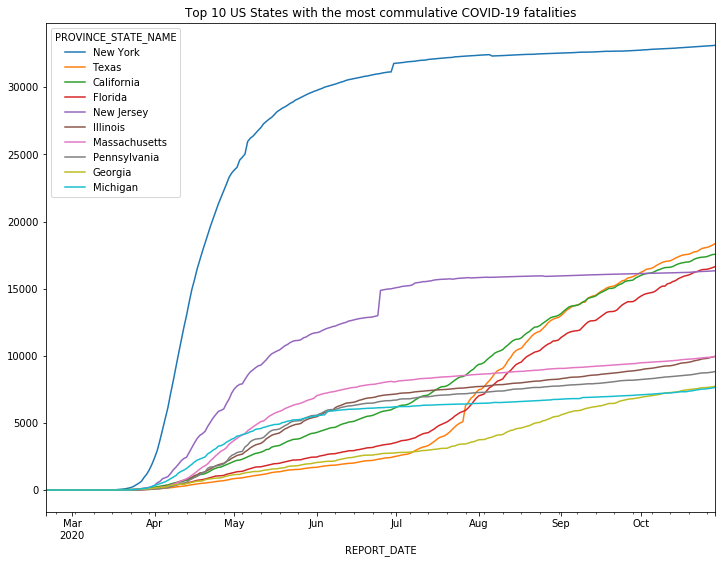

In [12]:
df_usp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0).iloc[30::][top_10].plot.line(
    figsize=(12,9),
    title="Top 10 US States with the most commulative COVID-19 fatalities"
);

The graphs below show the growth trends by state.  Note that the left axis is not standardized between states so it's important to look at the magnitude.

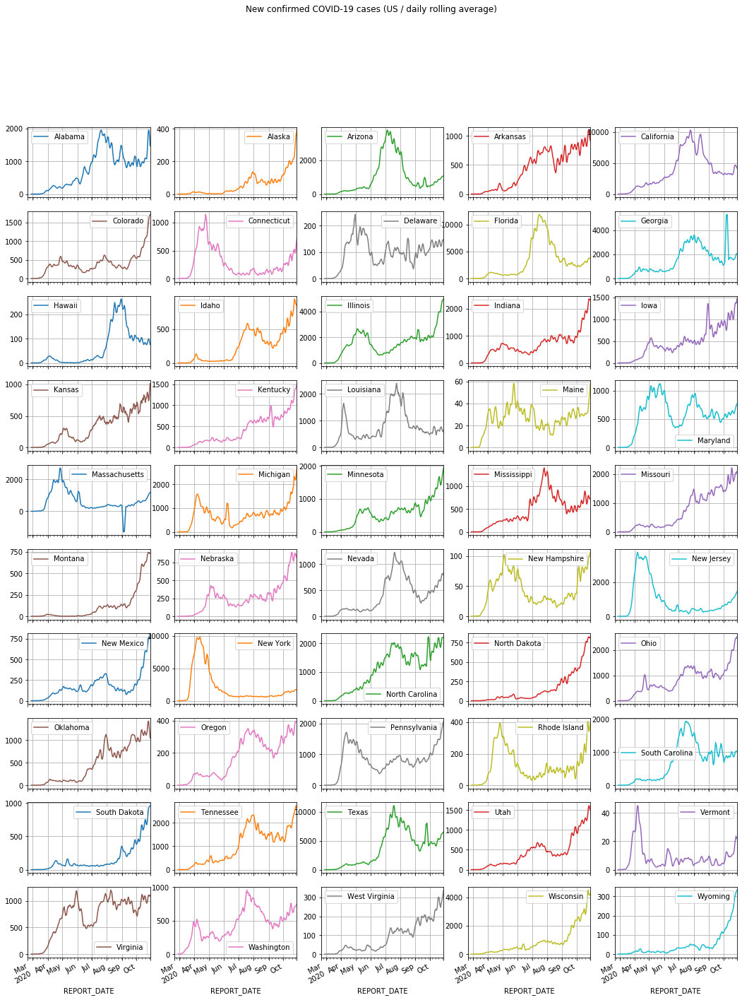

In [13]:
df_usp.xs('PEOPLE_POSITIVE_CASES_COUNT', axis=1, level=0).iloc[30::].rolling(window=5).mean().diff().rolling(3).mean().plot(
    subplots=True, 
#     ylim=(-10,25), 
    layout=(10,5), 
    figsize=(18,24),
    grid=True, 
    title='New confirmed COVID-19 cases (US / daily rolling average)',
);
plt.savefig('./out/covid_cases_us_trends.png');

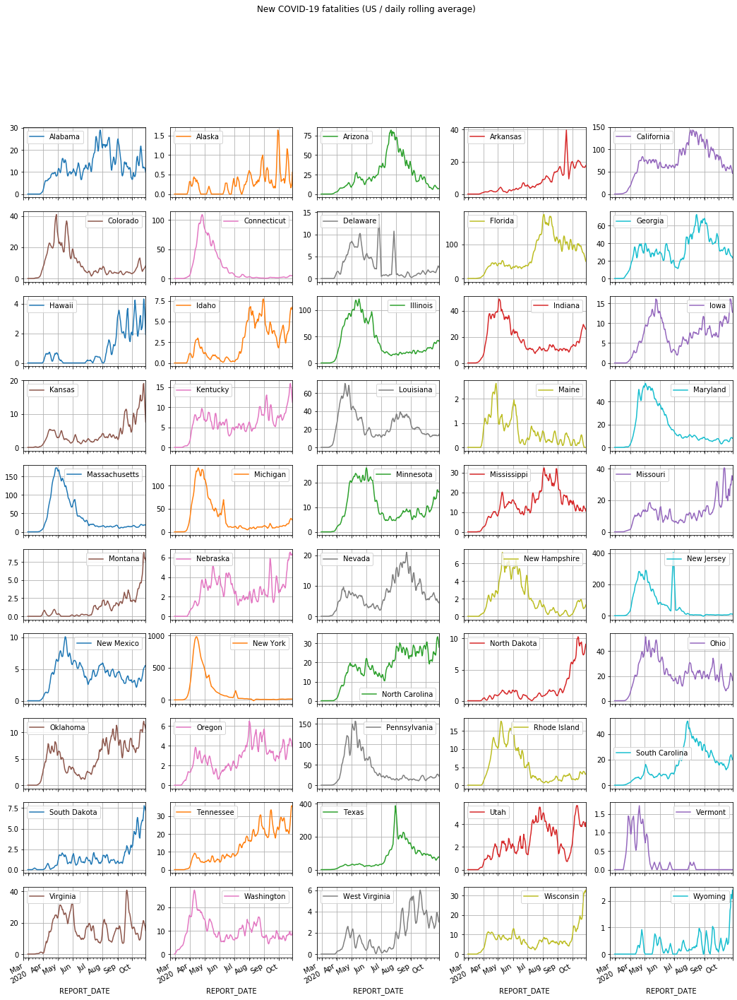

In [14]:
df_usp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0).iloc[30::].rolling(window=5).mean().diff().rolling(5).mean().plot(
    subplots=True, 
#     ylim=(-10,25), 
    layout=(10,5), 
    figsize=(18,24),
    grid=True, 
    title='New COVID-19 fatalities (US / daily rolling average)',
);
plt.savefig('./out/covid_deaths_us_trends.png');

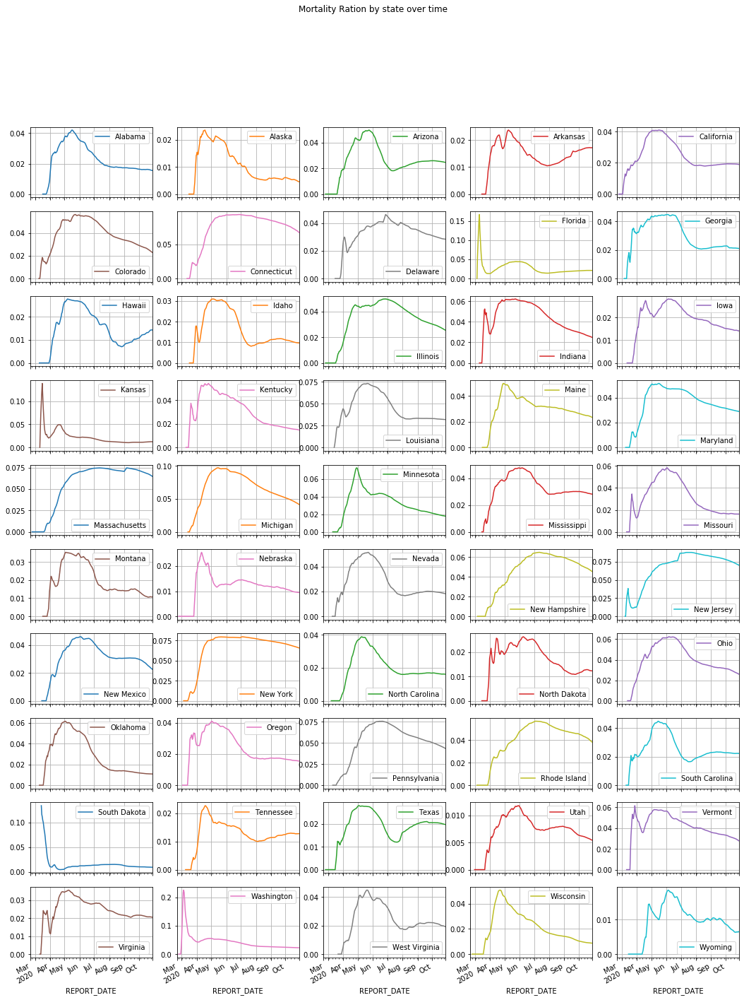

In [15]:
df_usp.xs('MORTALITY_RATIO', axis=1, level=0).iloc[30::].rolling(window=5).mean().plot(
    subplots=True, 
#     ylim=(-10,25), 
    layout=(10,5), 
    figsize=(18,24),
    grid=True, 
    title='Mortality Ratio by state over time',
);

# Global Trends

In [16]:
df_cp = df.groupby(['REPORT_DATE','COUNTRY_SHORT_NAME']).sum()[
    [
        'PEOPLE_POSITIVE_CASES_COUNT', 
        'PEOPLE_POSITIVE_NEW_CASES_COUNT', 
        'PEOPLE_DEATH_COUNT', 
        'PEOPLE_DEATH_NEW_COUNT'
    ]
]
df_cp['MORTALITY_RATIO'] = df_cp['PEOPLE_DEATH_COUNT']/df_cp['PEOPLE_POSITIVE_CASES_COUNT']
df_cp = df_cp.unstack().copy()

In [17]:
top_10c = df_cp.xs('PEOPLE_POSITIVE_CASES_COUNT', axis=1, level=0).iloc[-5:-1].max().sort_values(ascending=False)[0:10].index.values
top_25c = df_cp.xs('PEOPLE_POSITIVE_CASES_COUNT', axis=1, level=0).iloc[-5:-1].max().sort_values(ascending=False)[0:25].index.values

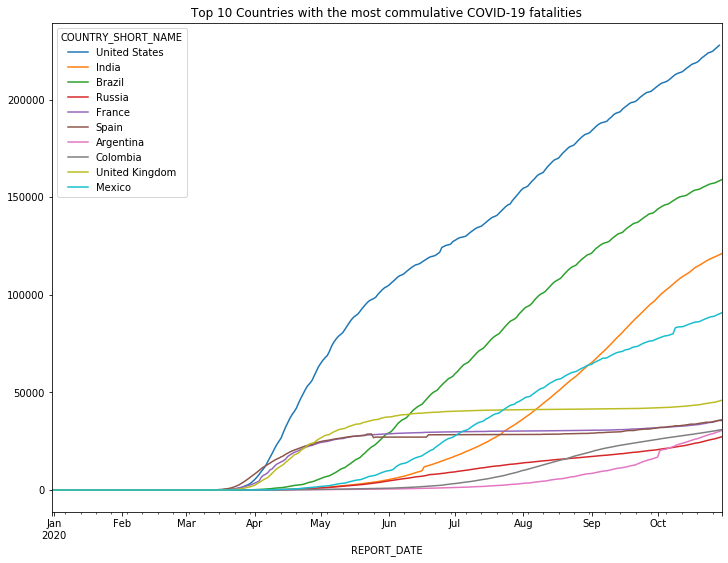

In [18]:
df_cp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0)[top_10c].plot.line(
    figsize=(12,9),
    title="Top 10 Countries with the most commulative COVID-19 fatalities"
);

The graphs below show the growth trends by country. Note that the left axis is not standardized between states so it's important to look at the magnitude.  Also note that this depends on accurate reporting by the countried themselves, which is questionable in some cases.

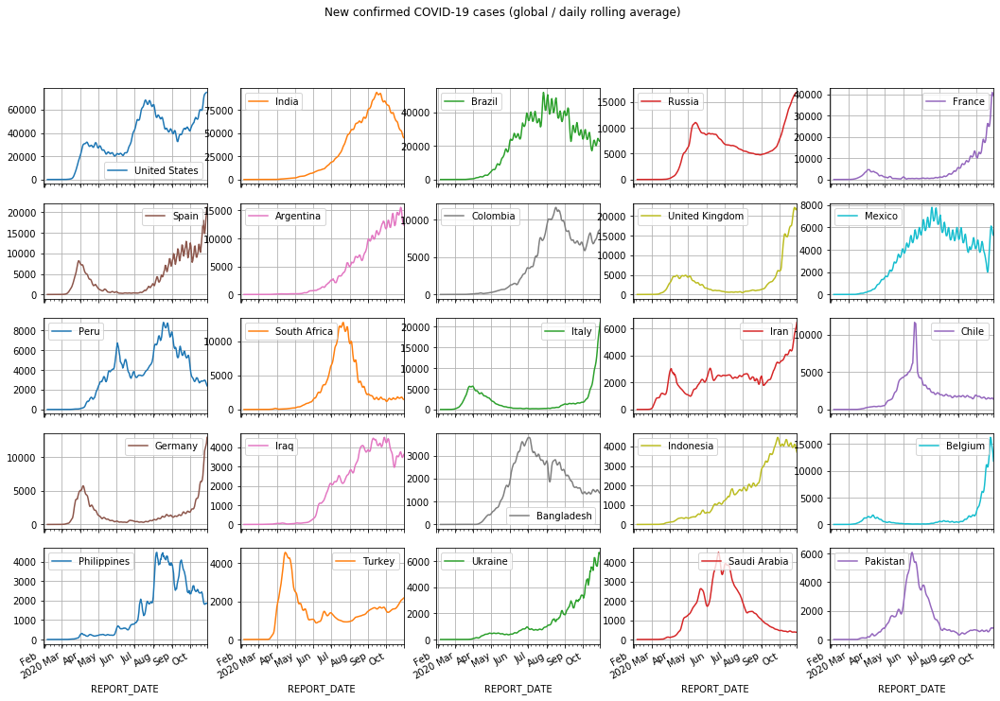

In [19]:
df_cp.xs('PEOPLE_POSITIVE_CASES_COUNT', axis=1, level=0).iloc[30::][top_25c].rolling(window=5).mean().diff().rolling(3).mean().plot(
    subplots=True, 
#     ylim=(-25,100), 
    grid=True, 
    layout=(5,5), 
    figsize=(18,12), 
#     cmap='tab20',
    title='New confirmed COVID-19 cases (global / daily rolling average)'
);
plt.savefig('./out/covid_cases_global_trends.png');

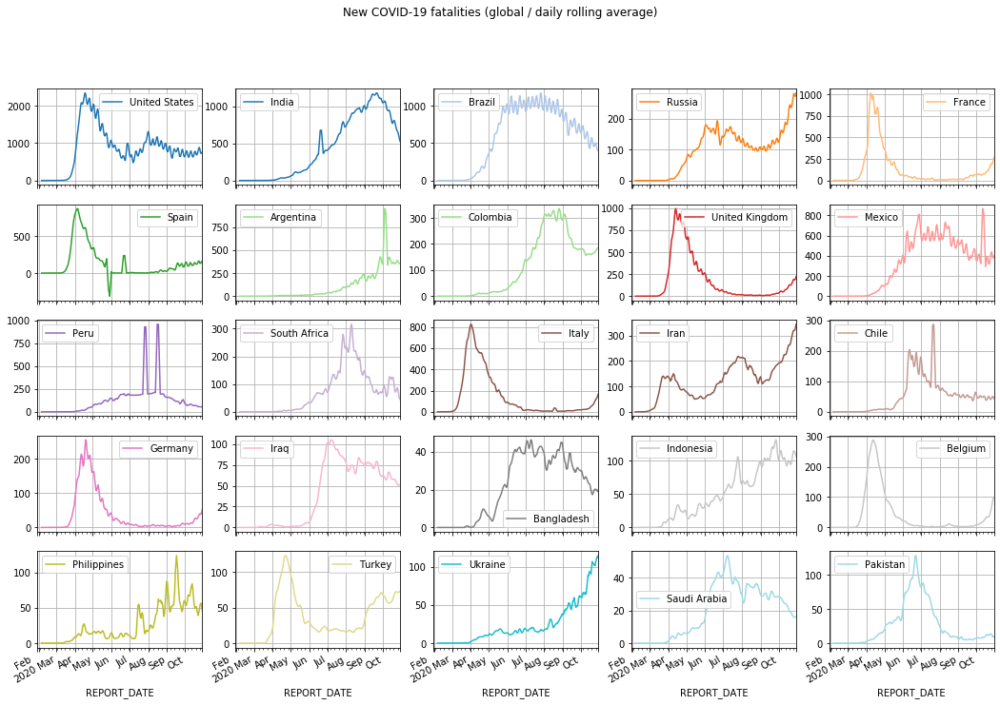

In [20]:
df_cp.xs('PEOPLE_DEATH_COUNT', axis=1, level=0).iloc[30::][top_25c].rolling(window=5).mean().diff().rolling(3).mean().plot(
    subplots=True, 
#     ylim=(-25,100), 
    grid=True, 
    layout=(5,5), 
    figsize=(18,12), 
    cmap='tab20',
    title='New COVID-19 fatalities (global / daily rolling average)'
);
# fig.write_image('./out/covid_deaths_global_trend.png');

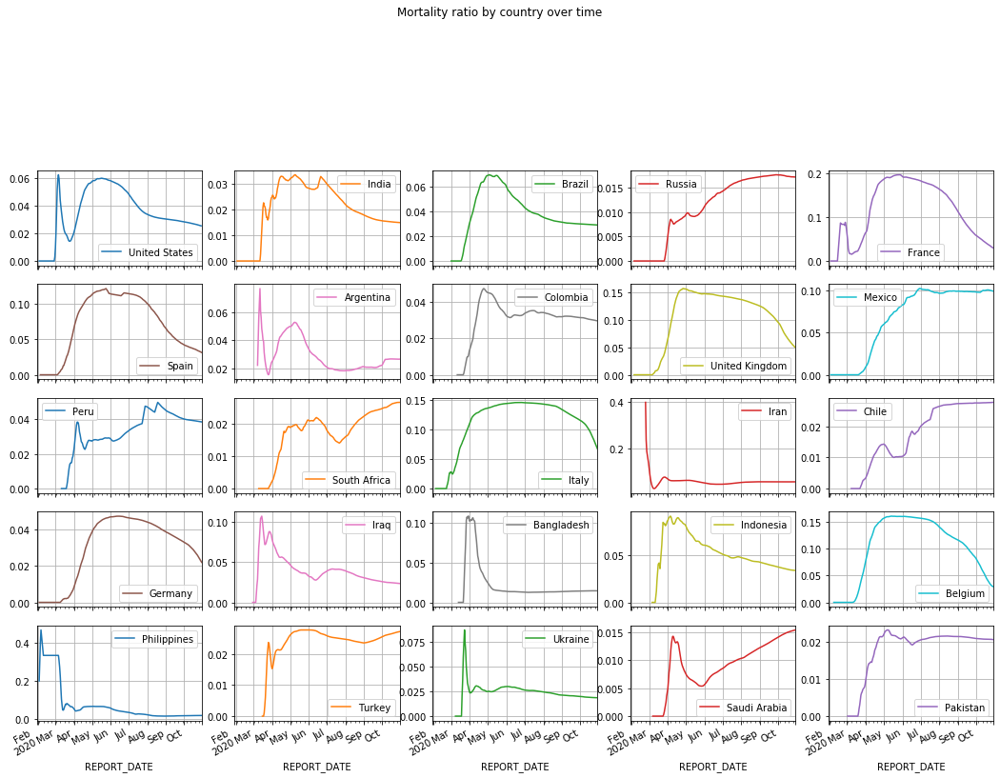

In [21]:
df_cp.xs('MORTALITY_RATIO', axis=1, level=0).iloc[30::][top_25c].rolling(window=5).mean().plot(
    subplots=True, 
#     ylim=(-10,25), 
    layout=(10,5), 
    figsize=(18,24),
    grid=True, 
    title='Mortality ratio by country over time',
);

# Population Normed Comparisons

In [22]:
df_statepop = pd.read_csv('/Users/dcripe/dev/code/notebooks/data_common/nst-est2019-alldata.csv').iloc[5::]

In [23]:
df_countrypop = pd.read_csv('/Users/dcripe/dev/code/notebooks/data_common/world_pop_2020.csv')

In [24]:
df_usppop = df_usp.iloc[-1].swaplevel(0,1).unstack().merge(df_statepop[['NAME','POPESTIMATE2019']], left_index=True, right_on='NAME').set_index('NAME')

In [25]:
df_cppop = df_cp.iloc[-5:-1].max().swaplevel(0,1).unstack().merge(df_countrypop[['country_code','population', 'country']], left_index=True, right_on='country').set_index('country')
df_cppop_lg = df_cppop[df_cppop['population'] > 10000000]

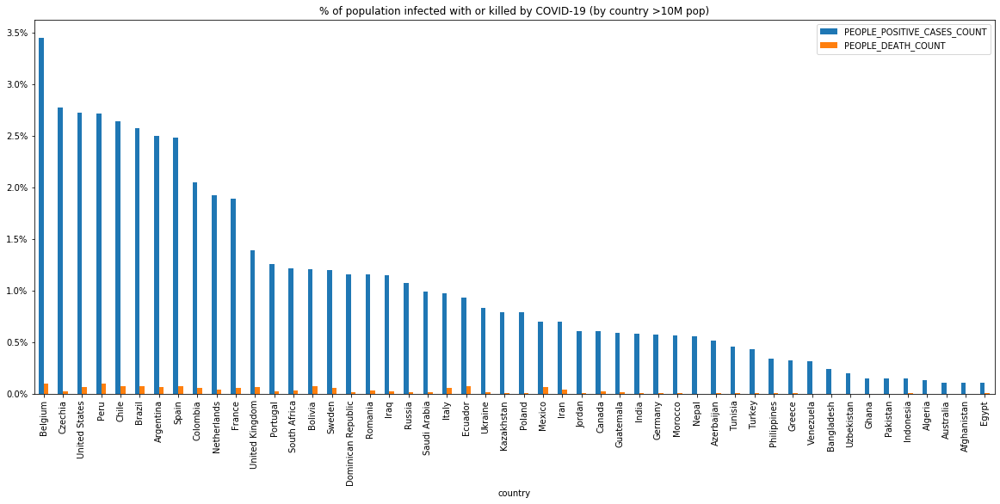

In [26]:
ax = df_cppop_lg[df_cppop_lg.columns[0:4]].div(df_cppop_lg['population'], axis=0)[['PEOPLE_POSITIVE_CASES_COUNT','PEOPLE_DEATH_COUNT']].sort_values(ascending=False, by='PEOPLE_POSITIVE_CASES_COUNT')[0:50].plot.bar(
    figsize=(20,8), 
    title="% of population infected with or killed by COVID-19 (by country >10M pop)",
#     stacked=True,
#     logy=True
#     icons='child', 
#     icon_size=18, 
#     icon_legend=True,
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals]);

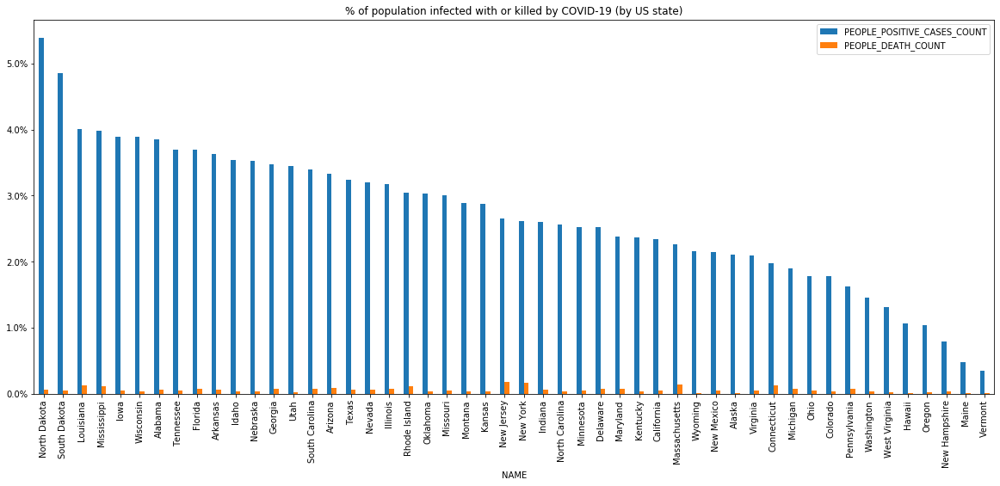

In [27]:
ax = df_usppop[df_usppop.columns[0:4]].div(df_usppop['POPESTIMATE2019'], axis=0)[['PEOPLE_POSITIVE_CASES_COUNT','PEOPLE_DEATH_COUNT']].sort_values(ascending=False, by='PEOPLE_POSITIVE_CASES_COUNT')[0:50].plot.bar(
    figsize=(20,8), 
    title="% of population infected with or killed by COVID-19 (by US state)",
#     stacked=True,
#     logy=True
#     icons='child', 
#     icon_size=18, 
#     icon_legend=True,
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals]);

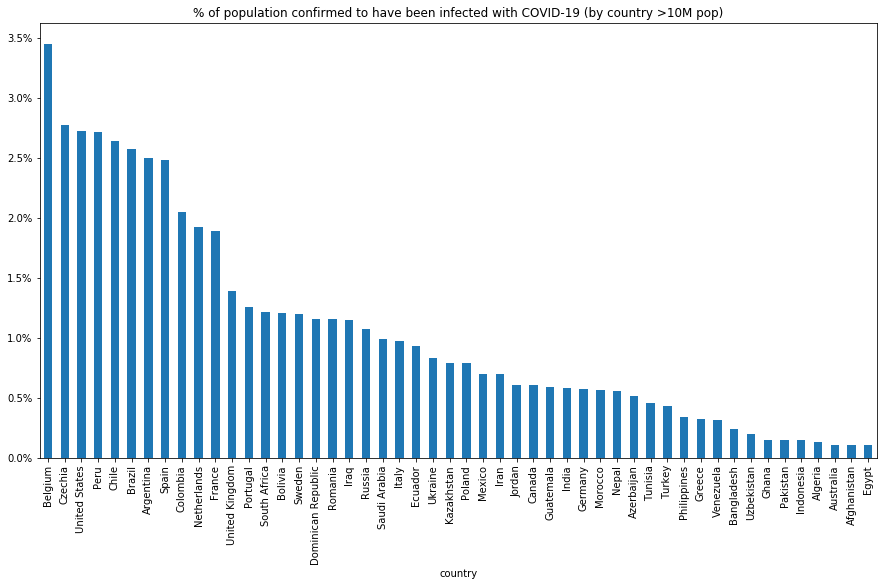

In [28]:
ax = (df_cppop_lg['PEOPLE_POSITIVE_CASES_COUNT']/df_cppop_lg['population']).sort_values(ascending=False)[0:50].plot.bar(
    figsize=(15,8), 
    title="% of population confirmed to have been infected with COVID-19 (by country >10M pop)",
#     icons='child', 
#     icon_size=18, 
#     icon_legend=True,
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals]);

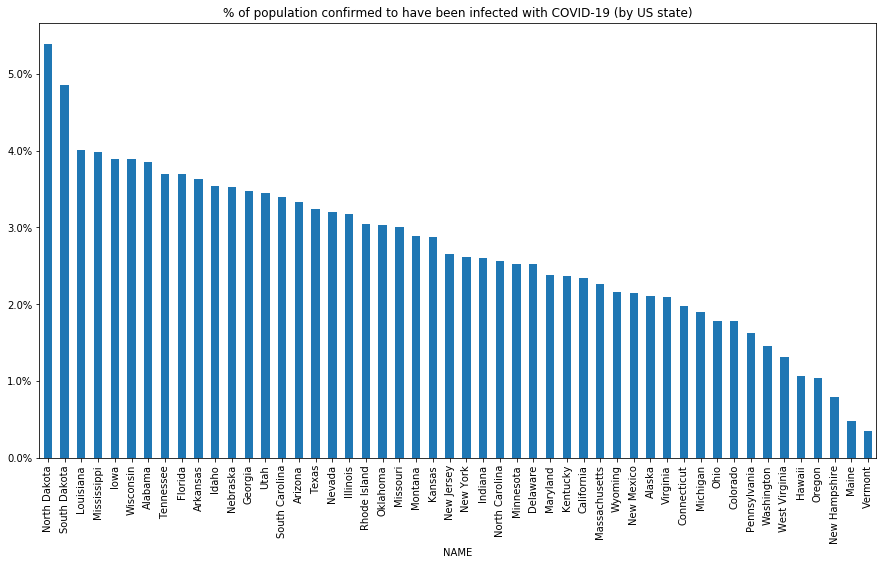

In [29]:
ax = (df_usppop['PEOPLE_POSITIVE_CASES_COUNT']/df_usppop['POPESTIMATE2019']).sort_values(ascending=False).plot.bar(
    figsize=(15,8), 
    title="% of population confirmed to have been infected with COVID-19 (by US state)",
#     icons='child', 
#     icon_size=18, 
#     icon_legend=True,
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals]);

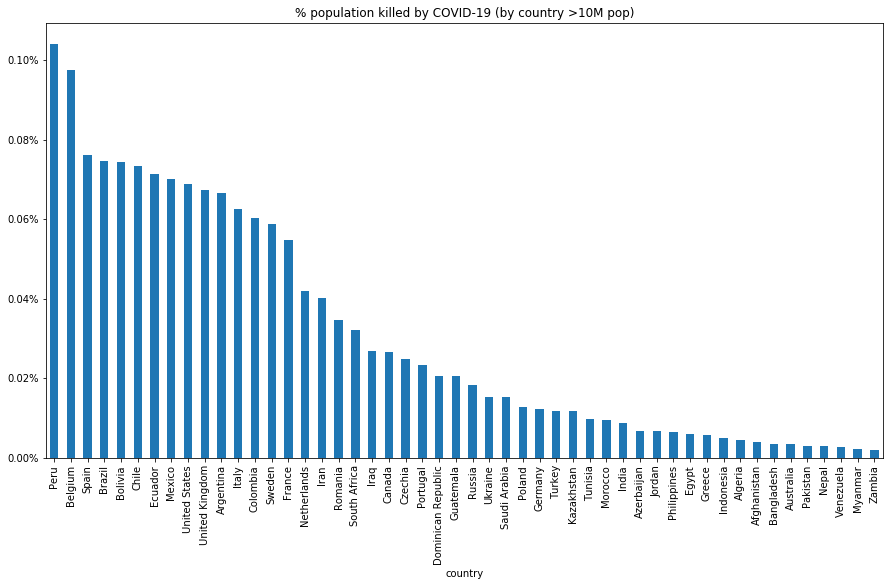

In [30]:
ax = (df_cppop_lg['PEOPLE_DEATH_COUNT']/df_cppop_lg['population']).sort_values(ascending=False)[0:50].plot.bar(
    figsize=(15,8), 
    title="% population killed by COVID-19 (by country >10M pop)",
#     icons='child', 
#     icon_size=18, 
#     icon_legend=True,
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.2%}'.format(x) for x in vals]);

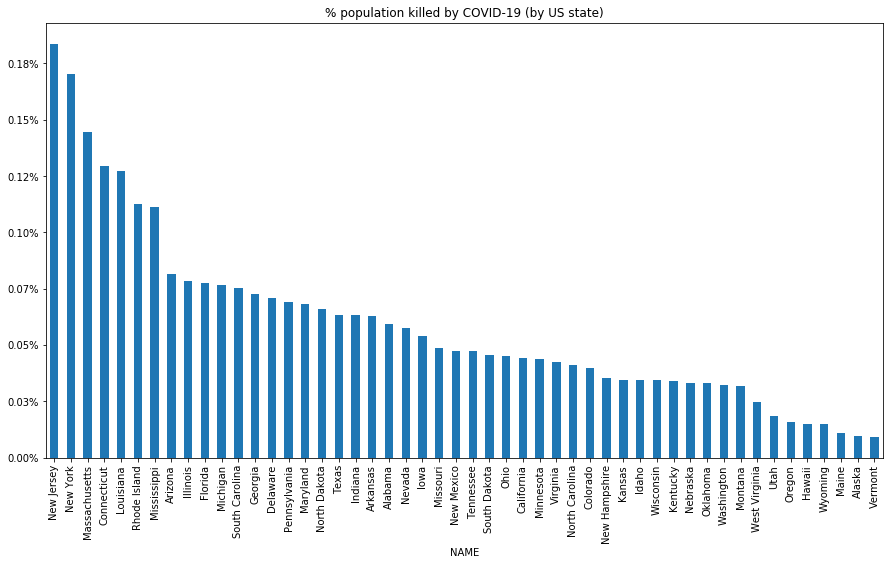

In [31]:
ax = (df_usppop['PEOPLE_DEATH_COUNT']/df_usppop['POPESTIMATE2019']).sort_values(ascending=False).plot.bar(
    figsize=(15,8), 
    title="% population killed by COVID-19 (by US state)"
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.2%}'.format(x) for x in vals]);


The chart below shows the "mortality" of COVID-19 by region.  The very wide range of mortality could be due to very different potency of the virus in different regions (unlikely), differences in testing and reporting accuracy (more likely) or lag (since fatalities happen days or weeks after infection).  Germany seems to have the most robust testing and reporting system at the moment and their mortality rate hovers between 4-5%. 

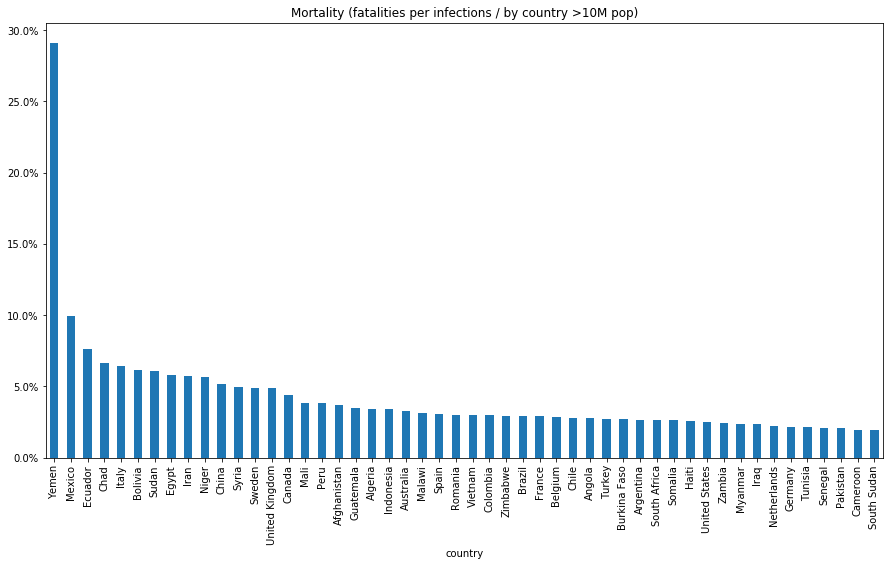

In [32]:
ax = (df_cppop_lg['PEOPLE_DEATH_COUNT']/df_cppop_lg['PEOPLE_POSITIVE_CASES_COUNT']).sort_values(ascending=False)[0:50].plot.bar(
    figsize=(15,8), 
    title="Mortality (fatalities per infections / by country >10M pop)"
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals]);

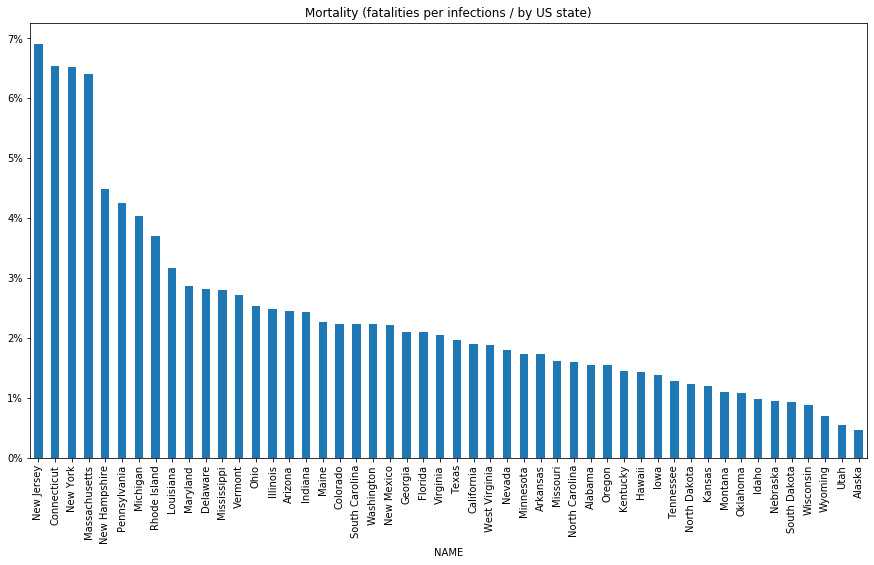

In [33]:
ax = (df_usppop['PEOPLE_DEATH_COUNT']/df_usppop['PEOPLE_POSITIVE_CASES_COUNT']).sort_values(ascending=False).plot.bar(
    figsize=(15,8), 
    title="Mortality (fatalities per infections / by US state)"
);
vals = ax.get_yticks();
ax.set_yticklabels(['{:,.0%}'.format(x) for x in vals]);

# infected population

In [34]:
per_x = 100000

In [35]:
df_per = df_usp.iloc[-14::].sum().swaplevel(0,1).unstack().merge(df_statepop[['NAME','POPESTIMATE2019']], left_index=True, right_on='NAME').set_index('NAME')


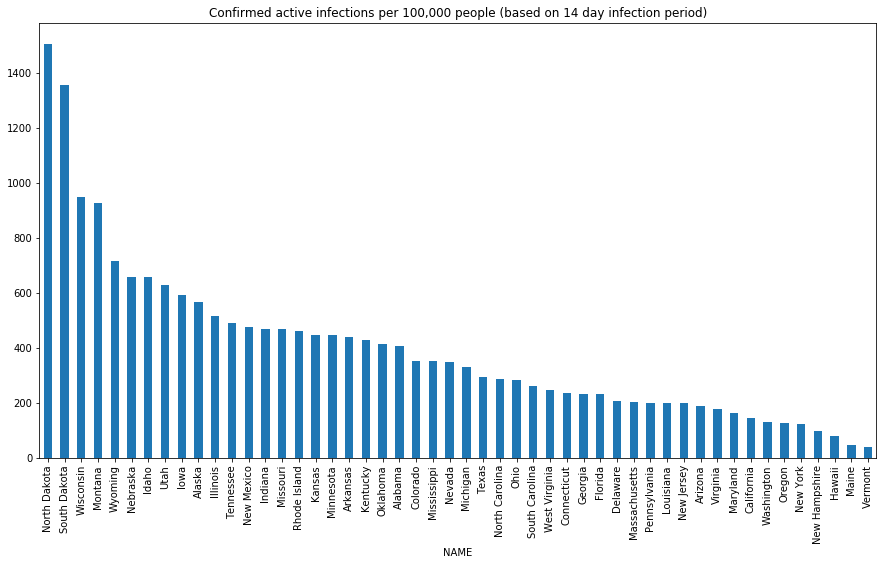

In [36]:
(df_per['PEOPLE_POSITIVE_NEW_CASES_COUNT']/df_per['POPESTIMATE2019']*per_x).sort_values(ascending=False).plot.bar(
    figsize=(15,8), 
    title="Confirmed active infections per {0:,} people (based on 14 day infection period)".format(per_x)
);

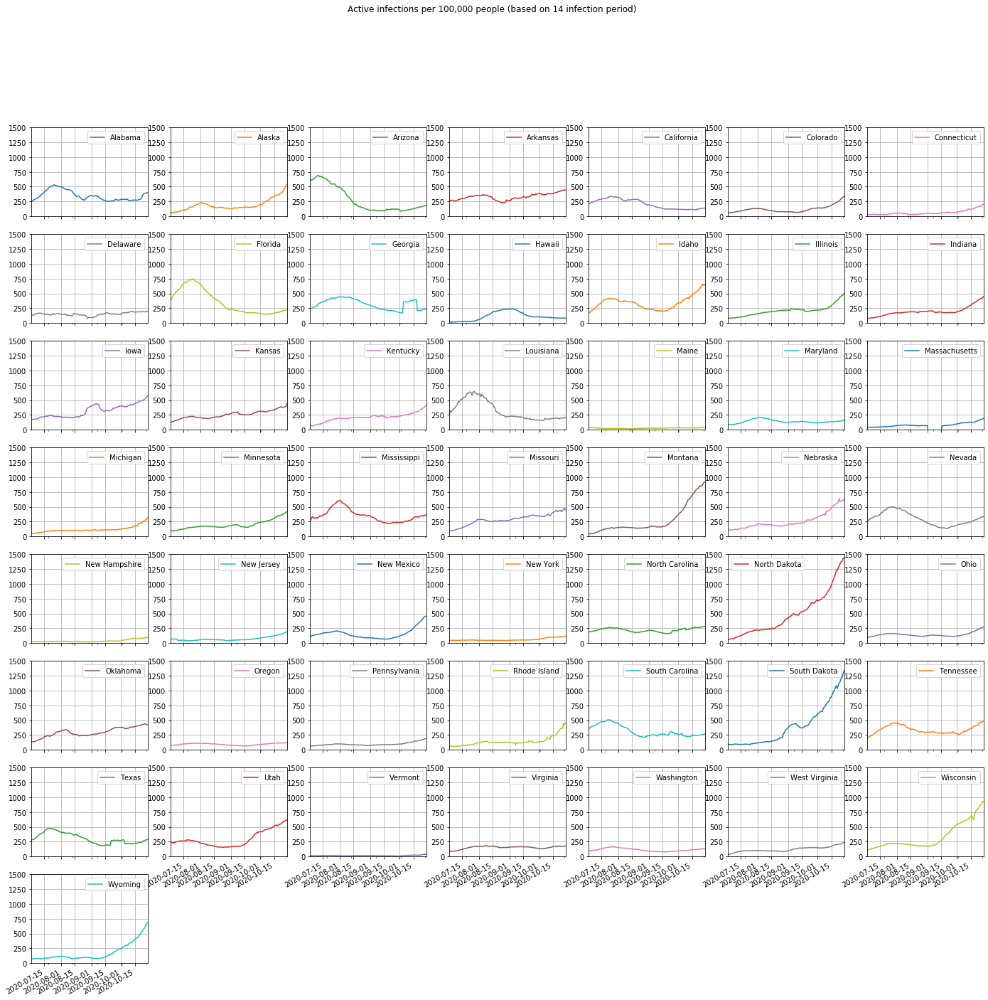

In [73]:
df_rinf = df_usp.xs('PEOPLE_POSITIVE_NEW_CASES_COUNT', axis=1, level=0).rolling(window=14).sum().iloc[-120::].T.merge(
    df_statepop[['NAME','POPESTIMATE2019']], left_index=True, right_on='NAME').set_index('NAME')
df_rinf_popadj = (df_rinf[df_rinf.columns[0:-2]].div(df_rinf[df_rinf.columns[-1]], axis=0)*per_x)
df_rinf_popadj.T.plot(
    subplots=True, 
    ylim=(0,1500),
#     logy=True,
    grid=True, 
    layout=(8,7), 
    figsize=(24,24), 
#     cmap='tab20',
    title='Active infections per {0:,} people (based on 14 infection period)'.format(per_x)
);
plt.savefig('./out/covid_inf_per_100k_us.png')

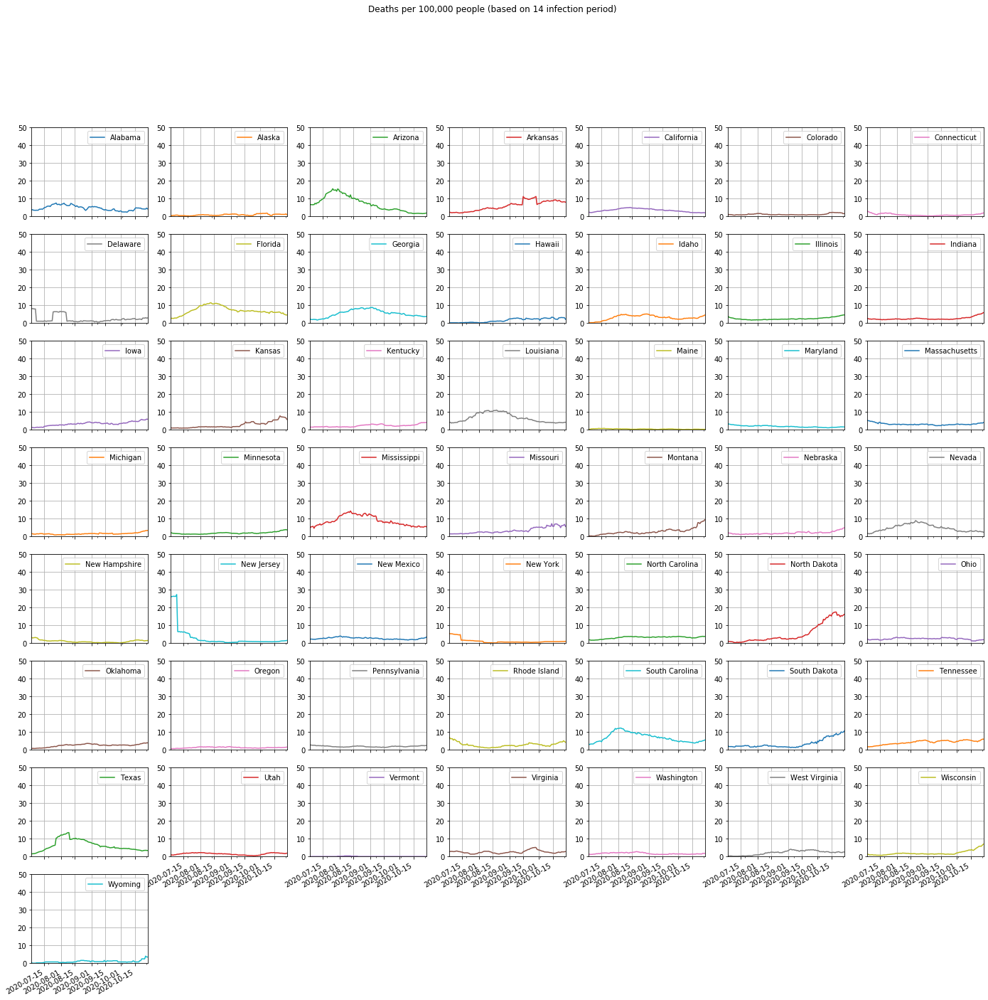

In [72]:
df_rinf = df_usp.xs('PEOPLE_DEATH_NEW_COUNT', axis=1, level=0).rolling(window=14).sum().iloc[-120::].T.merge(
    df_statepop[['NAME','POPESTIMATE2019']], left_index=True, right_on='NAME').set_index('NAME')
df_rinf_popadj = (df_rinf[df_rinf.columns[0:-2]].div(df_rinf[df_rinf.columns[-1]], axis=0)*per_x)
df_rinf_popadj.T.plot(
    subplots=True, 
    ylim=(0,50),
#     logy=True,
    grid=True, 
    layout=(8,7), 
    figsize=(24,24), 
#     cmap='tab20',
    title='Deaths per {0:,} people (based on 14 infection period)'.format(per_x)
);

In [38]:
df_states = pd.read_csv('/Users/dcripe/dev/code/notebooks/data_common/us_states.csv')

In [39]:
df_rinf_popadj_ansi = df_rinf_popadj.merge(df_states[['Subdivision name', 'Ansi']], left_index=True, right_on="Subdivision name" )

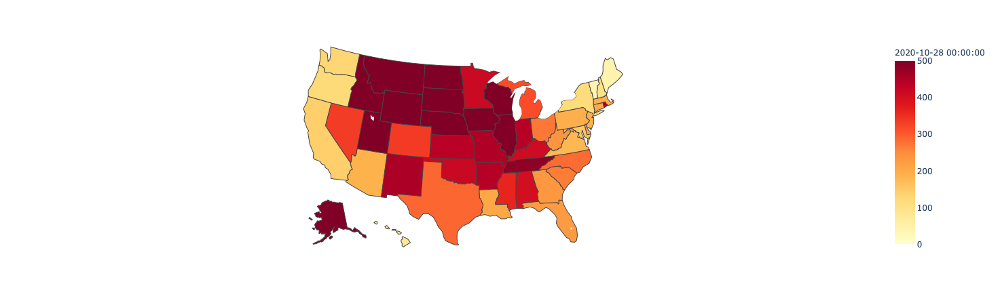

In [40]:
fig = px.choropleth(
    df_rinf_popadj_ansi,
    locations="Ansi", 
    locationmode="USA-states", 
    color=df_rinf_popadj_ansi.columns[-3],       
    color_continuous_scale="YlOrRd",
    range_color=(0, 500),    
    scope="usa",
    labels={df_rinf_popadj_ansi.columns[-3]:'Current cases per {0:,} people'.format(per_x)},
)
fig.show()

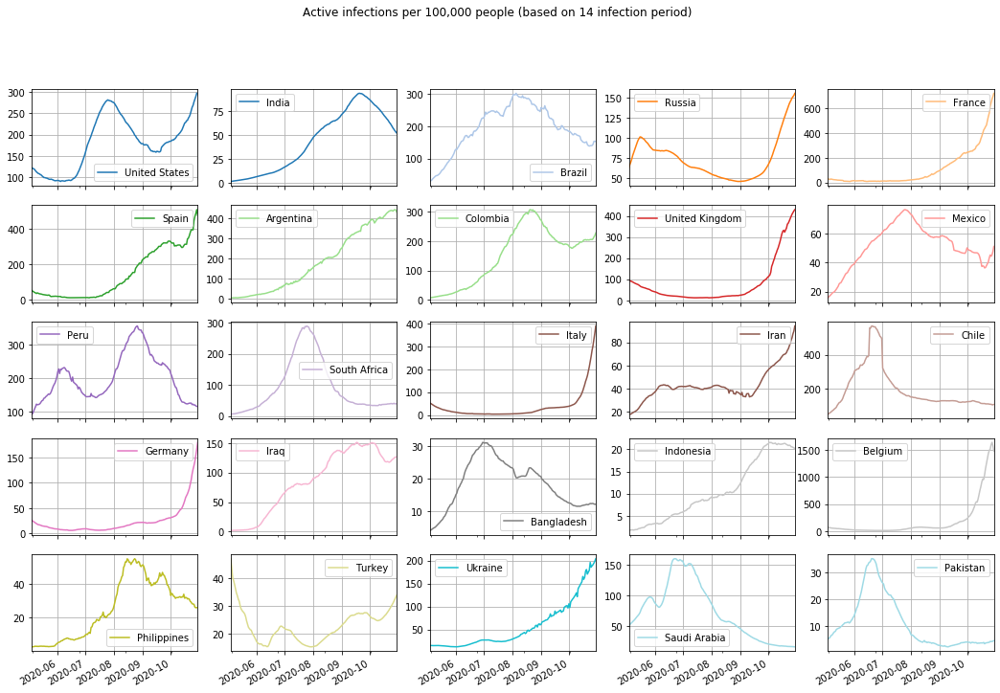

In [41]:
# df_trc = df.groupby(['Date','Country_Region','Case_Type']).agg({'Cases':sum,'Population_Count':sum})

df_rinfc = df_cp.xs('PEOPLE_POSITIVE_NEW_CASES_COUNT', axis=1, level=0)[top_25c].rolling(window=14).sum().iloc[-180::].T.merge(
    df_countrypop[['country_code','population', 'country']], left_index=True, right_on='country').set_index('country')

(df_rinfc[df_rinfc.columns[0:-2]].div(df_rinfc[df_rinfc.columns[-1]], axis=0)*per_x).T.plot(
    subplots=True, 
#     ylim=(0.01,50),
#     logy=True,
    grid=True, 
    layout=(5,5), 
    figsize=(18,12), 
    cmap='tab20',
    title='Active infections per {0:,} people (based on 14 infection period)'.format(per_x)
);

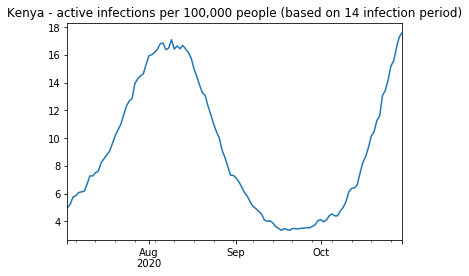

In [42]:
df_rinfc = df_cp.xs('PEOPLE_POSITIVE_NEW_CASES_COUNT', axis=1, level=0).rolling(window=14).sum().iloc[-120::].T.merge(
    df_countrypop[['country_code','population', 'country']], left_index=True, right_on='country').set_index('country')
df_rinfc_perx = (df_rinfc[df_rinfc.columns[0:-2]].div(df_rinfc[df_rinfc.columns[-1]], axis=0)*per_x)
df_rinfc_perx.loc['Kenya'].plot.line(title='Kenya - active infections per {0:,} people (based on 14 infection period)'.format(per_x))

# county data

In [43]:
def make_fips(st, ct):
    return "{0:02d}{1:03d}".format(st, ct)

In [44]:
df_countypop = pd.read_csv('/Users/dcripe/dev/code/notebooks/data_common/co-est2019-alldata.csv', engine='python')

In [45]:
df_countypop['fips'] = df_countypop.apply(lambda x: make_fips(x['STATE'],x['COUNTY']), axis=1)

In [46]:
# extract NYC population since COVID dataset bundles all NYC counties as one location
nyc_pop = df_countypop[df_countypop['CTYNAME'].isin(['New York County','Kings County','Bronx County','Richmond County','Queens County'])]['POPESTIMATE2019'].sum()
nyc_pop

8746127

In [47]:
def clean_county_name(name):   
    toks = name.split()
    if toks[-1] in ['County', 'Area', 'Municipality','Parish']:
        return " ".join(toks[0:-1])
    else:
        return name

In [48]:
df_countypop.head()

,SUMLEV,REGION,DIVISION,STATE,COUNTY,STNAME,CTYNAME,CENSUS2010POP,ESTIMATESBASE2010,POPESTIMATE2010,POPESTIMATE2011,POPESTIMATE2012,POPESTIMATE2013,POPESTIMATE2014,POPESTIMATE2015,POPESTIMATE2016,POPESTIMATE2017,POPESTIMATE2018,POPESTIMATE2019,NPOPCHG_2010,NPOPCHG_2011,NPOPCHG_2012,NPOPCHG_2013,NPOPCHG_2014,NPOPCHG_2015,...,RINTERNATIONALMIG2014,RINTERNATIONALMIG2015,RINTERNATIONALMIG2016,RINTERNATIONALMIG2017,RINTERNATIONALMIG2018,RINTERNATIONALMIG2019,RDOMESTICMIG2011,RDOMESTICMIG2012,RDOMESTICMIG2013,RDOMESTICMIG2014,RDOMESTICMIG2015,RDOMESTICMIG2016,RDOMESTICMIG2017,RDOMESTICMIG2018,RDOMESTICMIG2019,RNETMIG2011,RNETMIG2012,RNETMIG2013,RNETMIG2014,RNETMIG2015,RNETMIG2016,RNETMIG2017,RNETMIG2018,RNETMIG2019,fips
0,40,3,6,1,0,Alabama,Alabama,4779736,4780125,4785437,4799069,4815588,4830081,4841799,4852347,4863525,4874486,4887681,4903185,5312,13632,16519,14493,11718,10548,...,0.762,0.945,1.189,0.618,0.692,0.566,-0.395,-0.024,0.476,-0.198,-0.319,-0.444,0.472,1.082,1.918,0.578,1.186,1.523,0.563,0.626,0.745,1.090,1.774,2.484,01000
1,50,3,6,1,1,Alabama,Autauga County,54571,54597,54773,55227,54954,54727,54893,54864,55243,55390,55533,55869,176,454,-273,-227,166,-29,...,0.128,0.237,-0.054,-0.217,-0.126,-0.287,5.945,-5.972,-4.121,1.843,-1.950,4.832,1.067,0.667,4.847,6.018,-6.226,-3.902,1.970,-1.713,4.777,0.850,0.541,4.560,01001
2,50,3,6,1,3,Alabama,Baldwin County,182265,182265,183112,186558,190145,194885,199183,202939,207601,212521,217855,223234,847,3446,3587,4740,4298,3756,...,0.574,0.652,0.877,0.409,0.451,0.363,15.684,16.220,21.692,19.611,17.074,20.402,21.989,24.276,24.018,16.642,17.489,22.751,20.184,17.726,21.279,22.398,24.727,24.381,01003
3,50,3,6,1,5,Alabama,Barbour County,27457,27455,27327,27341,27169,26937,26755,26283,25806,25157,24872,24686,-128,14,-172,-232,-182,-472,...,0.149,0.490,0.653,0.471,0.480,0.525,0.476,-6.458,-7.763,-5.289,-16.215,-18.891,-25.469,-9.235,-5.690,0.293,-6.898,-8.132,-5.140,-15.725,-18.238,-24.999,-8.755,-5.166,01005
4,50,3,6,1,7,Alabama,Bibb County,22915,22915,22870,22745,22667,22521,22553,22566,22586,22550,22367,22394,-45,-125,-78,-146,32,13,...,0.621,0.576,0.620,0.443,0.445,0.447,-5.437,-4.624,-6.683,0.710,0.754,-1.329,-3.678,-7.302,1.385,-4.998,-3.788,-5.798,1.331,1.330,-0.709,-3.235,-6.857,1.832,01007


In [49]:
df_countypop.groupby(['REGION','DIVISION','STNAME'])['CENSUS2010POP'].sum()

REGION  DIVISION  STNAME              
1       1         Connecticut              7148194
                  Maine                    2656722
                  Massachusetts           13095258
                  New Hampshire            2632940
                  Rhode Island             2105134
                  Vermont                  1251482
        2         New Jersey              17583788
                  New York                38756204
                  Pennsylvania            25404758
2       3         Illinois                25661264
                  Indiana                 12967604
                  Michigan                19767280
                  Ohio                    23073008
                  Wisconsin               11373972
        4         Iowa                     6092710
                  Kansas                   5706236
                  Minnesota               10607850
                  Missouri                11977854
                  Nebraska                 

In [50]:
df_countypop['CTYNAME_SHORT'] = df_countypop['CTYNAME'].apply(lambda x: clean_county_name(x))
df_countypop['STATE-COUNTY'] = df_countypop.apply(lambda x: "{0}, {1}".format(x['CTYNAME_SHORT'],x['STNAME']), axis=1)

In [51]:
df_us['STATE-COUNTY'] = df_us.apply(lambda x: "{0}, {1}".format(x['COUNTY_NAME'],x['PROVINCE_STATE_NAME']), axis=1)

In [52]:
df_uscp = df_us.groupby(['REPORT_DATE','STATE-COUNTY']).sum()[
    [
        'PEOPLE_POSITIVE_CASES_COUNT', 
        'PEOPLE_POSITIVE_NEW_CASES_COUNT', 
        'PEOPLE_DEATH_COUNT', 
        'PEOPLE_DEATH_NEW_COUNT'
    ]
].unstack().copy()

In [53]:
df_uscp.tail()

PEOPLE_POSITIVE_CASES_COUNT                                       \
STATE-COUNTY   Abbeville, South Carolina Acadia, Louisiana Accomack, Virginia   
REPORT_DATE                                                                     
2020-10-25                       747.000         3,121.000          1,207.000   
2020-10-26                       754.000         3,119.000          1,210.000   
2020-10-27                       760.000         3,139.000          1,211.000   
2020-10-28                       768.000         3,147.000          1,214.000   
2020-10-29                       779.000         3,158.000          1,214.000   

                                                                     \
STATE-COUNTY Ada, Idaho Adair, Iowa Adair, Kentucky Adair, Missouri   
REPORT_DATE                                                           
2020-10-25   16,179.000     161.000         512.000         538.000   
2020-10-26   16,460.000     170.000         525.000         550.000   
2020-10-27   16,600.000     178.000         535.000         550.000   
2020-10-28   16,745.000     191.000         547.000         575.000   
2020-10-29   16,962.000     197.000         558.000         594.000   

                                                                           \
STATE-COUNTY Adair, Oklahoma Adams, Colorado Adams, Idaho Adams, Illinois   
REPORT_DATE                                                                 
2020-10-25           788.000      13,356.000       48.000       1,885.000   
2020-10-26           795.000      13,724.000       57.000       1,924.000   
2020-10-27           801.000      13,945.000       57.000       1,985.000   
2020-10-28           815.000      14,173.000       58.000       2,107.000   
2020-10-29           819.000      14,523.000       63.000       2,131.000   

                                                                            \
STATE-COUNTY Adams, Indiana Adams, Iowa Adams, Mississippi Adams, Nebraska   
REPORT_DATE                                                                  
2020-10-25          524.000      81.000          1,085.000         814.000   
2020-10-26          561.000      81.000          1,089.000         839.000   
2020-10-27          578.000      83.000          1,093.000         861.000   
2020-10-28          618.000      84.000          1,094.000         878.000   
2020-10-29          634.000      84.000          1,102.000         896.000   

                                                                  \
STATE-COUNTY Adams, North Dakota Adams, Ohio Adams, Pennsylvania   
REPORT_DATE                                                        
2020-10-25                73.000     215.000           1,084.000   
2020-10-26                75.000     226.000           1,100.000   
2020-10-27                79.000     233.000           1,118.000   
2020-10-28                80.000     244.000           1,133.000   
2020-10-29                85.000     254.000           1,144.000   

                                                                  \
STATE-COUNTY Adams, Washington Adams, Wisconsin Addison, Vermont   
REPORT_DATE                                                        
2020-10-25             913.000          489.000          120.000   
2020-10-26             917.000          500.000          120.000   
2020-10-27             917.000          535.000          120.000   
2020-10-28             922.000          548.000          120.000   
2020-10-29             924.000          581.000          122.000   

                                                                       \
STATE-COUNTY Aiken, South Carolina Aitkin, Minnesota Alachua, Florida   
REPORT_DATE                                                             
2020-10-25               4,934.000           179.000       10,044.000   
2020-10-26               4,947.000           179.000       10,114.000   
2020-10-27               4,989.000           186.000       10,196.000   
2020-10-28               

In [54]:
df_uscppop = df_uscp.iloc[-14::].sum().swaplevel(0,1).unstack().merge(df_countypop[['STATE-COUNTY','REGION','DIVISION','STNAME','CTYNAME_SHORT','fips','POPESTIMATE2019']], left_index=True, right_on='STATE-COUNTY').set_index('STATE-COUNTY')

In [55]:
df_us[df_us['PEOPLE_POSITIVE_NEW_CASES_COUNT'] < 0]

,PEOPLE_POSITIVE_CASES_COUNT,COUNTY_NAME,PROVINCE_STATE_NAME,REPORT_DATE,CONTINENT_NAME,DATA_SOURCE_NAME,PEOPLE_DEATH_NEW_COUNT,COUNTY_FIPS_NUMBER,COUNTRY_ALPHA_3_CODE,COUNTRY_SHORT_NAME,COUNTRY_ALPHA_2_CODE,PEOPLE_POSITIVE_NEW_CASES_COUNT,PEOPLE_DEATH_COUNT,STATE-COUNTY
64029,748.000,Karnes,Texas,2020-09-08,America,New York Times,0,"48,255.000",USA,United States,US,-2,13.000,"Karnes, Texas"
64037,128.000,Lexington,South Carolina,2020-04-08,America,New York Times,0,"45,063.000",USA,United States,US,-2,5.000,"Lexington, South Carolina"
64060,653.000,San Juan,Utah,2020-08-15,America,New York Times,0,"49,037.000",USA,United States,US,-2,26.000,"San Juan, Utah"
64215,246.000,Hardin,Ohio,2020-09-15,America,New York Times,0,"39,065.000",USA,United States,US,-2,13.000,"Hardin, Ohio"
64790,12.000,Lauderdale,Alabama,2020-03-29,America,New York Times,0,"1,077.000",USA,United States,US,-1,1.000,"Lauderdale, Alabama"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
991613,71.000,Sublette,Wyoming,2020-09-21,America,New York Times,0,"56,035.000",USA,United States,US,-2,1.000,"Sublette, Wyoming"
991661,97.000,Sublette,Wyoming,2020-09-27,America,New York Times,0,"56,035.000",USA,United States,US,-1,1.000,"Sublette, Wyoming"
991673,45.000,Crook,Wyoming,2020-09-29,America,New York Times,0,"56,011.000",USA,United States,US,-1,0.000,"Crook, Wyoming"
991854,715.000,Teton,Wyoming,2020-10-21,America,New York Times,0,"56,039.000",USA,United States,US,-1,1.000,"Teton, Wyoming"


In [56]:
df_uscppop['14D_CASES_POP_ADJ'] = (df_uscppop['PEOPLE_POSITIVE_NEW_CASES_COUNT']/df_uscppop['POPESTIMATE2019']*per_x)
df_uscppop['14D_DEATHS_POP_ADJ'] = (df_uscppop['PEOPLE_DEATH_NEW_COUNT']/df_uscppop['POPESTIMATE2019']*per_x)

In [57]:
df_us.head()

,PEOPLE_POSITIVE_CASES_COUNT,COUNTY_NAME,PROVINCE_STATE_NAME,REPORT_DATE,CONTINENT_NAME,DATA_SOURCE_NAME,PEOPLE_DEATH_NEW_COUNT,COUNTY_FIPS_NUMBER,COUNTRY_ALPHA_3_CODE,COUNTRY_SHORT_NAME,COUNTRY_ALPHA_2_CODE,PEOPLE_POSITIVE_NEW_CASES_COUNT,PEOPLE_DEATH_COUNT,STATE-COUNTY
63593,0.000,Autauga,Alabama,2020-01-21,America,New York Times,0,"1,001.000",USA,United States,US,0,0.000,"Autauga, Alabama"
63594,0.000,Butler,Alabama,2020-01-21,America,New York Times,0,"1,013.000",USA,United States,US,0,0.000,"Butler, Alabama"
63595,0.000,Chilton,Alabama,2020-01-21,America,New York Times,0,"1,021.000",USA,United States,US,0,0.000,"Chilton, Alabama"
63596,0.000,Coosa,Alabama,2020-01-21,America,New York Times,0,"1,037.000",USA,United States,US,0,0.000,"Coosa, Alabama"
63597,0.000,Covington,Alabama,2020-01-21,America,New York Times,0,"1,039.000",USA,United States,US,0,0.000,"Covington, Alabama"


In [58]:
df_us[df_us['PROVINCE_STATE_NAME'] == 'Montana']['COUNTY_NAME'].sort_values().unique()

array(['Beaverhead', 'Big Horn', 'Blaine', 'Broadwater', 'Carbon',
       'Carter', 'Cascade', 'Chouteau', 'Custer', 'Daniels', 'Dawson',
       'Deer Lodge', 'Fallon', 'Fergus', 'Flathead', 'Gallatin',
       'Garfield', 'Glacier', 'Golden Valley', 'Granite', 'Hill',
       'Jefferson', 'Judith Basin', 'Lake', 'Lewis and Clark', 'Liberty',
       'Lincoln', 'Madison', 'McCone', 'Meagher', 'Mineral', 'Missoula',
       'Musselshell', 'Park', 'Petroleum', 'Phillips', 'Pondera',
       'Powder River', 'Powell', 'Prairie', 'Ravalli', 'Richland',
       'Roosevelt', 'Rosebud', 'Sanders', 'Sheridan', 'Silver Bow',
       'Stillwater', 'Sweet Grass', 'Teton', 'Toole', 'Treasure',
       'Unknown', 'Valley', 'Wheatland', 'Wibaux', 'Yellowstone'],
      dtype=object)

In [59]:
df_uscppop[df_uscppop['CTYNAME_SHORT'] == 'Dona Anna']

,PEOPLE_POSITIVE_CASES_COUNT,PEOPLE_POSITIVE_NEW_CASES_COUNT,PEOPLE_DEATH_COUNT,PEOPLE_DEATH_NEW_COUNT,REGION,DIVISION,STNAME,CTYNAME_SHORT,fips,POPESTIMATE2019,14D_CASES_POP_ADJ,14D_DEATHS_POP_ADJ
STATE-COUNTY,,,,,,,,,,,,


In [60]:
df_uscppop[df_uscppop['14D_CASES_POP_ADJ']>100]

,PEOPLE_POSITIVE_CASES_COUNT,PEOPLE_POSITIVE_NEW_CASES_COUNT,PEOPLE_DEATH_COUNT,PEOPLE_DEATH_NEW_COUNT,REGION,DIVISION,STNAME,CTYNAME_SHORT,fips,POPESTIMATE2019,14D_CASES_POP_ADJ,14D_DEATHS_POP_ADJ
STATE-COUNTY,,,,,,,,,,,,
"Abbeville, South Carolina","10,271.000",78.000,215.000,2.000,3,5,South Carolina,Abbeville,45001,24527,318.017,8.154
"Acadia, Louisiana","43,405.000",103.000,"1,401.000",2.000,3,7,Louisiana,Acadia,22001,62045,166.009,3.223
"Ada, Idaho","221,479.000","2,121.000","2,271.000",19.000,4,8,Idaho,Ada,16001,481587,440.419,3.945
"Adair, Iowa","2,141.000",81.000,14.000,0.000,2,4,Iowa,Adair,19001,7152,"1,132.550",0.000
"Adair, Kentucky","6,961.000",120.000,312.000,2.000,3,6,Kentucky,Adair,21001,19202,624.935,10.416
...,...,...,...,...,...,...,...,...,...,...,...,...
"Yuba, California","18,118.000",100.000,140.000,0.000,4,9,California,Yuba,06115,78668,127.116,0.000
"Yuma, Arizona","187,997.000",643.000,"4,946.000",5.000,4,8,Arizona,Yuma,04027,213787,300.767,2.339
"Yuma, Colorado","2,804.000",46.000,14.000,0.000,4,8,Colorado,Yuma,08125,10019,459.128,0.000


In [61]:
df_uscppop.groupby('DIVISION').agg({'14D_CASES_POP_ADJ':[np.median,np.mean,max]})

14D_CASES_POP_ADJ                   
                    median    mean        max
DIVISION                                     
1                   70.195 107.834    450.909
2                  143.088 170.377    819.600
3                  438.224 535.448  2,655.838
4                  606.008 784.153 10,998.406
5                  212.761 253.022  1,004.611
6                  411.895 462.295  3,631.768
7                  267.731 346.272  2,676.561
8                  422.971 546.279  3,434.505
9                   99.423 134.003    813.670

In [62]:
df_uscppop.groupby('DIVISION').agg({'14D_DEATHS_POP_ADJ':[np.median,np.mean,max]})

14D_DEATHS_POP_ADJ               
                     median   mean     max
DIVISION                                  
1                     0.000  1.199   8.058
2                     0.870  2.516  32.913
3                     2.940  7.276  77.715
4                     1.632 11.193 379.363
5                     2.975  5.422 118.133
6                     3.723  7.000 118.859
7                     3.188  6.779  86.580
8                     0.000  7.639 297.265
9                     0.771  1.754  29.938

In [63]:
df_uscppop['label'] = df_uscppop.apply(lambda x: "{0} (pop: {1:,})".format(x.CTYNAME_SHORT,x.POPESTIMATE2019), axis=1)

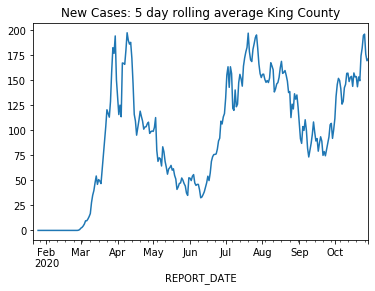

In [64]:
df_uscp.xs("King, Washington", axis=1, level=1)['PEOPLE_POSITIVE_NEW_CASES_COUNT'].rolling(window=5).mean().plot.line(title="New Cases: 5 day rolling average King County")

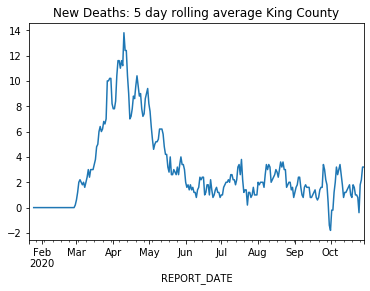

In [65]:
df_uscp.xs("King, Washington", axis=1, level=1)['PEOPLE_DEATH_NEW_COUNT'].rolling(window=5).mean().plot.line(title="New Deaths: 5 day rolling average King County")

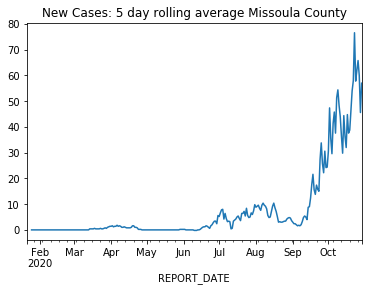

In [66]:
df_uscp.xs("Missoula, Montana", axis=1, level=1)['PEOPLE_POSITIVE_NEW_CASES_COUNT'].rolling(window=5).mean().plot.line(title="New Cases: 5 day rolling average Missoula County")

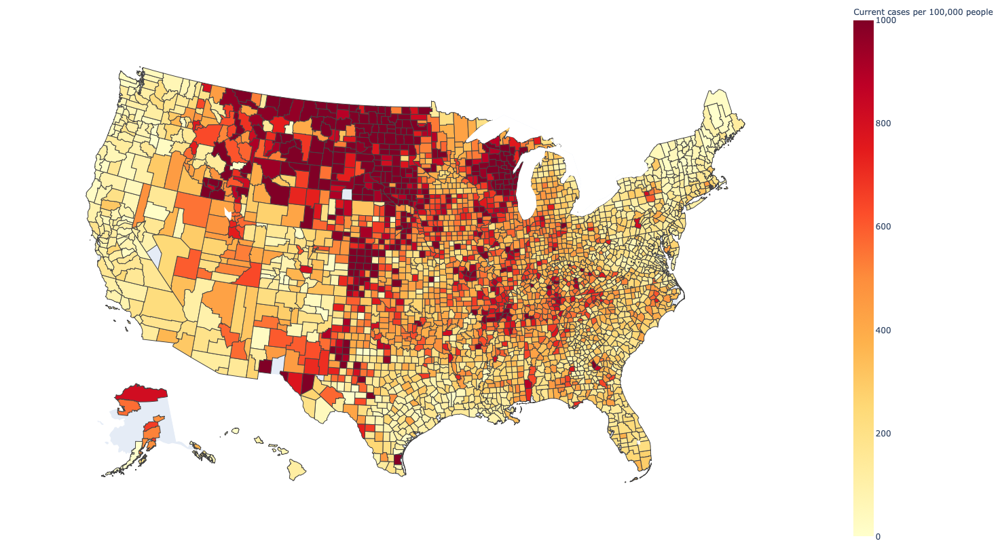

In [67]:
from urllib.request import urlopen
import json
import plotly.express as px

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth(
    df_uscppop, 
    geojson=counties, 
    locations='fips', 
    color='14D_CASES_POP_ADJ',       
    color_continuous_scale="YlOrRd",
#     color_continuous_scale="matter",
    range_color=(0, 1000),
#     color_continuous_midpoint=(250),
    scope="usa",
    labels={
        '14D_CASES_POP_ADJ':'Current cases per {0:,} people'.format(per_x), 
#         "POPESTIMATE2019":"Polulation",
    },
    hover_name='label',
    width=1200, 
    height=800,
)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
fig.write_image('./out/covid_inf_per_100k_us_map.png')

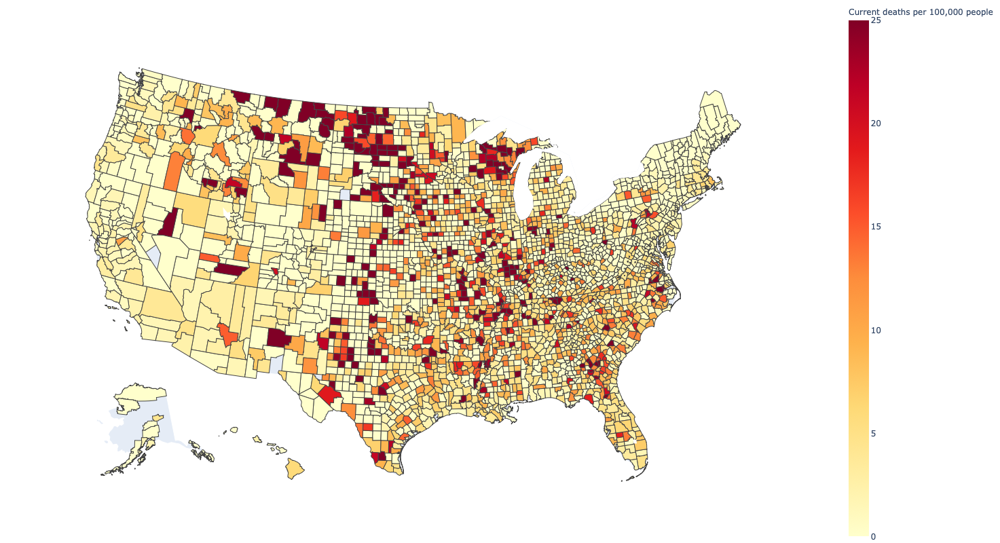

In [68]:
fig = px.choropleth(
    df_uscppop, 
    geojson=counties, 
    locations='fips', 
    color='14D_DEATHS_POP_ADJ',       
    color_continuous_scale="YlOrRd",
    range_color=(0, 25),
#     color_continuous_midpoint=(250),
    scope="usa",
    labels={
        '14D_DEATHS_POP_ADJ':'Current deaths per {0:,} people'.format(per_x), 
#         "POPESTIMATE2019":"Polulation",
    },
    hover_name='label',
    width=1200, 
    height=800,
)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()
fig.write_image('./out/covid_inf_per_100k_us_map.png')